# Philadelphia Crime Rates

You are a Data Analyst working for the Philadelphia police department. The department is trying to find any helpful trends in Crime rates to assist them in planning their work for 2017.

You have been supplied a dataset with crimes committed and recorded in the region for the period of 2006-2015. This is a large dataset with over 2,000,000 rows (excel will not be able to handle it).

The department wants to know and see visualizations for the following: 
1.  Overall trend in crimes for the whole period of time in the dataset. The granularity should be at the Day level.
2.  Which are the most and the least dangerous hours in Philadelphia?
3.  Is there any seasonality in the crime rate?
4.  What are the top 10 crimes crime types?
5.  Which police HQ is in the most need of strengthening?

## Credits

This notebook is a part of my learning path based on the workshops [Case Study 002 : [R] Philadelphia Crime Rates](https://www.superdatascience.com/casestudy002/) presented on [Super Data Science](http://www.superdatascience.com) platform.

SuperDataScience team publish a lot of courses (available on the [Udemy](https://www.udemy.com) platform) taught by [Kirill Eremenko](https://www.udemy.com/user/kirilleremenko/) and [Hadelin de Ponteves](https://www.udemy.com/user/hadelin-de-ponteves/) in the wide space of Data Science.

Here are the most valuable one in the field of Data Science, Machine Learning and Deep Learning:
1. [Data Science A-Z™: Real-Life Data Science Exercises Included](https://www.udemy.com/datascience/learn/v4/overview)
2. [Python A-Z™: Python For Data Science With Real Exercises!](https://www.udemy.com/python-coding/learn/v4/overview)
3. [R Programming A-Z™: R For Data Science With Real Exercises!](https://www.udemy.com/r-programming/learn/v4/overview)
4. [Machine Learning A-Z™: Hands-On Python & R In Data Science](https://www.udemy.com/machinelearning/learn/v4/overview)
5. [Deep Learning A-Z™: Hands-On Artificial Neural Networks](https://www.udemy.com/deeplearning/learn/v4/overview)
6. [Artificial Intelligence A-Z™: Learn How To Build An AI](https://www.udemy.com/artificial-intelligence-az/learn/v4/overview)

## Preparation

** Import libraries**

In [1]:
library(ggplot2)

** Load the data **

In [2]:
CrimeData <- read.csv("../../data/CrimeData.csv")

** Check the structure of the data **

In [3]:
str(CrimeData)

'data.frame':	210000 obs. of  3 variables:
 $ Dc_Dist           : int  25 16 35 4 35 18 9 9 16 39 ...
 $ Dispatch_Date_Time: Factor w/ 203738 levels "2006-01-01 00:00:00",..: 155400 22344 163607 31491 143036 184558 142522 7293 180588 166193 ...
 $ Text_General_Code : Factor w/ 33 levels "Aggravated Assault Firearm",..: 32 20 18 29 2 8 29 30 29 30 ...


In [4]:
head(CrimeData)

Dc_Dist,Dispatch_Date_Time,Text_General_Code
25,2013-05-28 22:18:00,Vandalism/Criminal Mischief
16,2006-12-10 19:42:00,Other Assaults
35,2013-10-24 22:06:00,Narcotic / Drug Law Violations
4,2007-05-14 18:33:00,Theft from Vehicle
35,2012-09-24 20:55:00,Aggravated Assault No Firearm
18,2014-12-14 02:19:00,DRIVING UNDER THE INFLUENCE


## 1. Overall trend in crimes for the whole period of time in the dataset. The granularity should be at the Day level.

First of all we can notice that the *Dispatch_Date_Time* column is in the wrong format. It's a factor column with a lot of levels. We axpect it to be time-series data where the *Dispatch_Date_Time* is in a proper date-time format. We need to convert it.

In [5]:
head(CrimeData$Dispatch_Date_Time)

[1] 2013-05-28 22:18:00 2006-12-10 19:42:00 2013-10-24 22:06:00
[4] 2007-05-14 18:33:00 2012-09-24 20:55:00 2014-12-14 02:19:00
203738 Levels: 2006-01-01 00:00:00 2006-01-01 00:15:00 ... 2015-12-31 23:46:00

Let's create a new filed *DateTime*. Note that the time of the crime is a Philadelphia time whist EST (Eastern Time Zone).

In [6]:
CrimeData$DateTime <- as.POSIXct(CrimeData$Dispatch_Date_Time, format="%Y-%m-%d %H:%M:%S", tz="EST")

In [7]:
?POSIXct

In [8]:
head(CrimeData$DateTime)

[1] "2013-05-28 22:18:00 EST" "2006-12-10 19:42:00 EST"
[3] "2013-10-24 22:06:00 EST" "2007-05-14 18:33:00 EST"
[5] "2012-09-24 20:55:00 EST" "2014-12-14 02:19:00 EST"

Let's also seperate the date alone as the granularity should be at the Day level. Note that we need to stick with the proper time zone.

In [9]:
CrimeData$Date <- as.Date(CrimeData$DateTime, tz="EST")
str(CrimeData)

'data.frame':	210000 obs. of  5 variables:
 $ Dc_Dist           : int  25 16 35 4 35 18 9 9 16 39 ...
 $ Dispatch_Date_Time: Factor w/ 203738 levels "2006-01-01 00:00:00",..: 155400 22344 163607 31491 143036 184558 142522 7293 180588 166193 ...
 $ Text_General_Code : Factor w/ 33 levels "Aggravated Assault Firearm",..: 32 20 18 29 2 8 29 30 29 30 ...
 $ DateTime          : POSIXct, format: "2013-05-28 22:18:00" "2006-12-10 19:42:00" ...
 $ Date              : Date, format: "2013-05-28" "2006-12-10" ...


Count number of crimes by day

In [10]:
by_date <- aggregate(CrimeData$Date, by = list(Date = CrimeData$Date), FUN = length)

In [11]:
?aggregate

In [12]:
str(by_date)

'data.frame':	3652 obs. of  2 variables:
 $ Date: Date, format: "2006-01-01" "2006-01-02" ...
 $ x   : int  58 53 66 73 61 60 57 80 76 47 ...


Rename columns

In [13]:
colnames(by_date) <- c("Date", "Total")

In [14]:
str(by_date)

'data.frame':	3652 obs. of  2 variables:
 $ Date : Date, format: "2006-01-01" "2006-01-02" ...
 $ Total: int  58 53 66 73 61 60 57 80 76 47 ...


In [15]:
head(by_date)

Date,Total
2006-01-01,58
2006-01-02,53
2006-01-03,66
2006-01-04,73
2006-01-05,61
2006-01-06,60


Plot the result

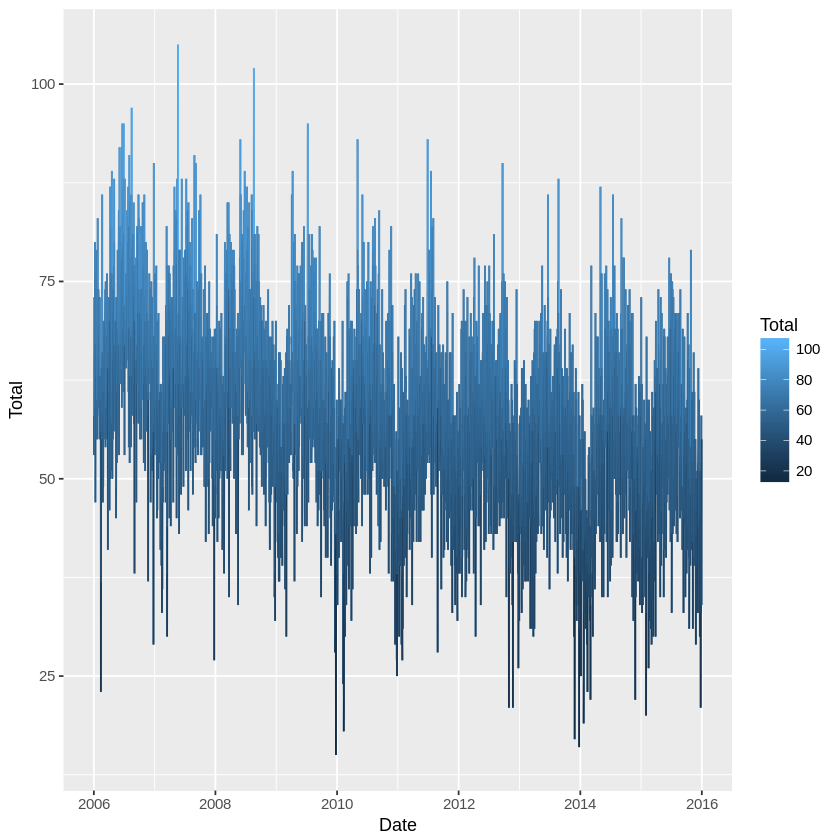

In [16]:
ggplot(by_date, aes(Date, Total, color=Total)) + geom_line()

## 2. Which are the most and the least dangerous hours in Philadelphia?

Get hours from Datetime column

In [17]:
CrimeData$Hour <- strftime(CrimeData$DateTime, format = '%H', tz='EST')

In [18]:
str(CrimeData)

'data.frame':	210000 obs. of  6 variables:
 $ Dc_Dist           : int  25 16 35 4 35 18 9 9 16 39 ...
 $ Dispatch_Date_Time: Factor w/ 203738 levels "2006-01-01 00:00:00",..: 155400 22344 163607 31491 143036 184558 142522 7293 180588 166193 ...
 $ Text_General_Code : Factor w/ 33 levels "Aggravated Assault Firearm",..: 32 20 18 29 2 8 29 30 29 30 ...
 $ DateTime          : POSIXct, format: "2013-05-28 22:18:00" "2006-12-10 19:42:00" ...
 $ Date              : Date, format: "2013-05-28" "2006-12-10" ...
 $ Hour              : chr  "22" "19" "22" "18" ...


Aggregate by hour

In [19]:
by_hour <- aggregate(CrimeData$Hour, by = list(Hour = CrimeData$Hour), FUN=length)

In [20]:
str(by_hour)

'data.frame':	24 obs. of  2 variables:
 $ Hour: chr  "00" "01" "02" "03" ...
 $ x   : int  11570 9242 6477 4367 2892 2207 2044 3581 7216 9030 ...


Rename columns

In [21]:
colnames(by_hour) <- c("Hour", "Total")

In [22]:
str(by_hour)

'data.frame':	24 obs. of  2 variables:
 $ Hour : chr  "00" "01" "02" "03" ...
 $ Total: int  11570 9242 6477 4367 2892 2207 2044 3581 7216 9030 ...


In [23]:
by_hour

Hour,Total
00,11570
01,9242
02,6477
03,4367
04,2892
05,2207
06,2044
07,3581
08,7216
09,9030


Convert categorical hours to integer

In [24]:
by_hour$Hour <- as.integer(by_hour$Hour)

In [25]:
str(by_hour)

'data.frame':	24 obs. of  2 variables:
 $ Hour : int  0 1 2 3 4 5 6 7 8 9 ...
 $ Total: int  11570 9242 6477 4367 2892 2207 2044 3581 7216 9030 ...


Plot the result

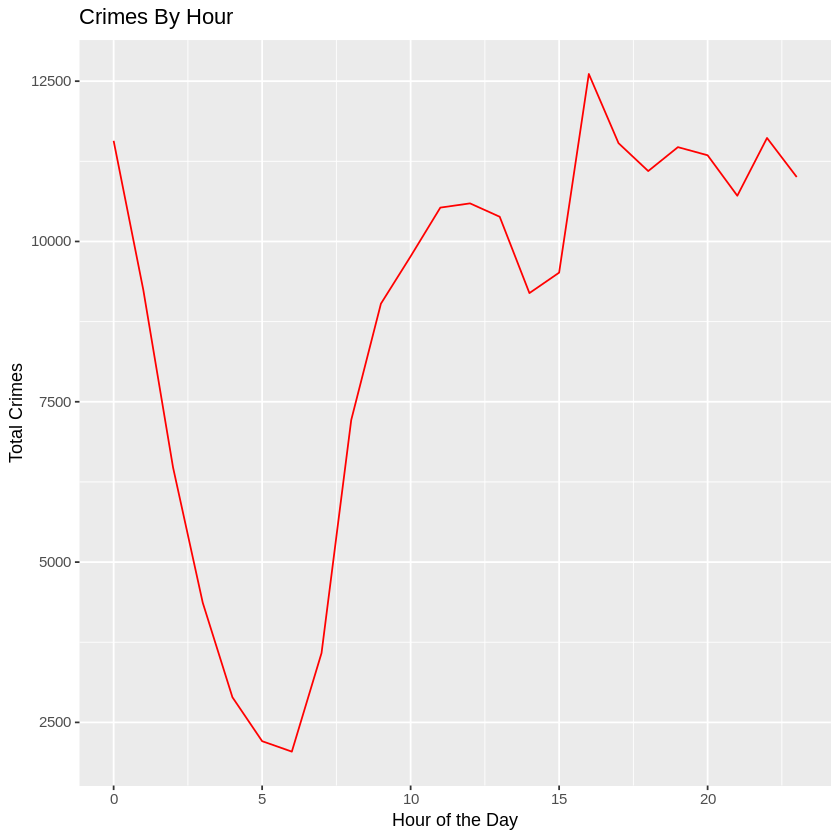

In [26]:
ggplot(by_hour, aes(Hour, Total)) +
  geom_line(colour="Red") +
  ggtitle("Crimes By Hour") +
  xlab("Hour of the Day") +
  ylab("Total Crimes")

## 3. Is there any seasonality in the crime rate?

Get months from Datetime column

In [27]:
CrimeData$Month <- strftime(CrimeData$DateTime, format = '%m', tz='EST')

In [28]:
str(CrimeData)

'data.frame':	210000 obs. of  7 variables:
 $ Dc_Dist           : int  25 16 35 4 35 18 9 9 16 39 ...
 $ Dispatch_Date_Time: Factor w/ 203738 levels "2006-01-01 00:00:00",..: 155400 22344 163607 31491 143036 184558 142522 7293 180588 166193 ...
 $ Text_General_Code : Factor w/ 33 levels "Aggravated Assault Firearm",..: 32 20 18 29 2 8 29 30 29 30 ...
 $ DateTime          : POSIXct, format: "2013-05-28 22:18:00" "2006-12-10 19:42:00" ...
 $ Date              : Date, format: "2013-05-28" "2006-12-10" ...
 $ Hour              : chr  "22" "19" "22" "18" ...
 $ Month             : chr  "05" "12" "10" "05" ...


Aggregate by month

In [29]:
by_month <- aggregate(CrimeData$Month, by = list(Month = CrimeData$Month), FUN=length)

In [30]:
str(by_month)

'data.frame':	12 obs. of  2 variables:
 $ Month: chr  "01" "02" "03" "04" ...
 $ x    : int  16129 14175 17301 18016 18663 19003 19392 19328 17825 18039 ...


Rename columns

In [31]:
colnames(by_month) <- c("Month", "Total")

In [32]:
str(by_month)

'data.frame':	12 obs. of  2 variables:
 $ Month: chr  "01" "02" "03" "04" ...
 $ Total: int  16129 14175 17301 18016 18663 19003 19392 19328 17825 18039 ...


Convert categorical months to integer

In [33]:
by_month$Month <- as.integer(by_month$Month)

In [34]:
str(by_month)

'data.frame':	12 obs. of  2 variables:
 $ Month: int  1 2 3 4 5 6 7 8 9 10 ...
 $ Total: int  16129 14175 17301 18016 18663 19003 19392 19328 17825 18039 ...


In [35]:
by_month

Month,Total
1,16129
2,14175
3,17301
4,18016
5,18663
6,19003
7,19392
8,19328
9,17825
10,18039


Plot the result

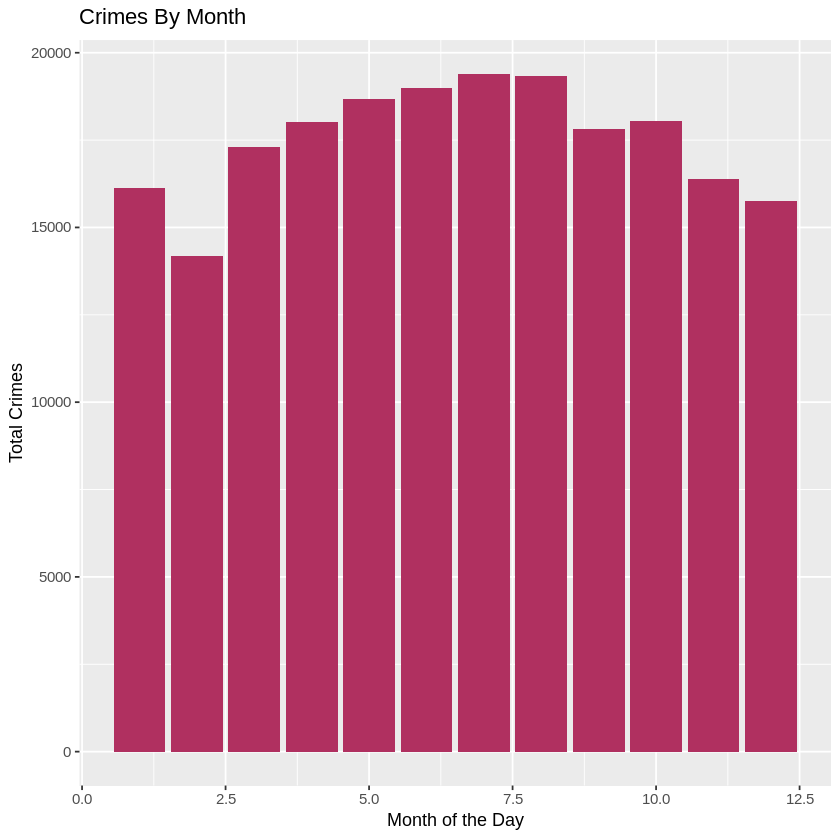

In [36]:
ggplot(by_month, aes(Month, Total)) +
  geom_bar(fill="Maroon", stat="identity")+
  ggtitle("Crimes By Month") +
  xlab("Month of the Day") +
  ylab("Total Crimes")

## 4 .What are the top 10 crimes crime types?

Count by type

In [37]:
by_category <- aggregate(CrimeData$Text_General_Code,
                         by = list(Typec = CrimeData$Text_General_Code),
                         FUN = length)

# rename columns
colnames(by_category) <- c("Type", "Total")

In [38]:
by_category

Type,Total
Aggravated Assault Firearm,2672
Aggravated Assault No Firearm,6477
All Other Offenses,41296
Arson,542
Burglary Non-Residential,2259
Burglary Residential,8925
Disorderly Conduct,3916
DRIVING UNDER THE INFLUENCE,5017
Embezzlement,457
Forgery and Counterfeiting,477


We need to sort it.

In [39]:
by_category_sorted <- by_category[order(by_category$Total, decreasing=T),]

In [40]:
by_category_sorted

,Type,Total
3,All Other Offenses,41296
20,Other Assaults,25486
30,Thefts,23888
32,Vandalism/Criminal Mischief,18792
29,Theft from Vehicle,16061
18,Narcotic / Drug Law Violations,13285
11,Fraud,10161
26,Recovered Stolen Motor Vehicle,8944
6,Burglary Residential,8925
2,Aggravated Assault No Firearm,6477


Select top 10 crimes

In [41]:
top10crimes <- by_category_sorted[1:10,]

In [42]:
top10crimes

,Type,Total
3,All Other Offenses,41296
20,Other Assaults,25486
30,Thefts,23888
32,Vandalism/Criminal Mischief,18792
29,Theft from Vehicle,16061
18,Narcotic / Drug Law Violations,13285
11,Fraud,10161
26,Recovered Stolen Motor Vehicle,8944
6,Burglary Residential,8925
2,Aggravated Assault No Firearm,6477


Plot the result

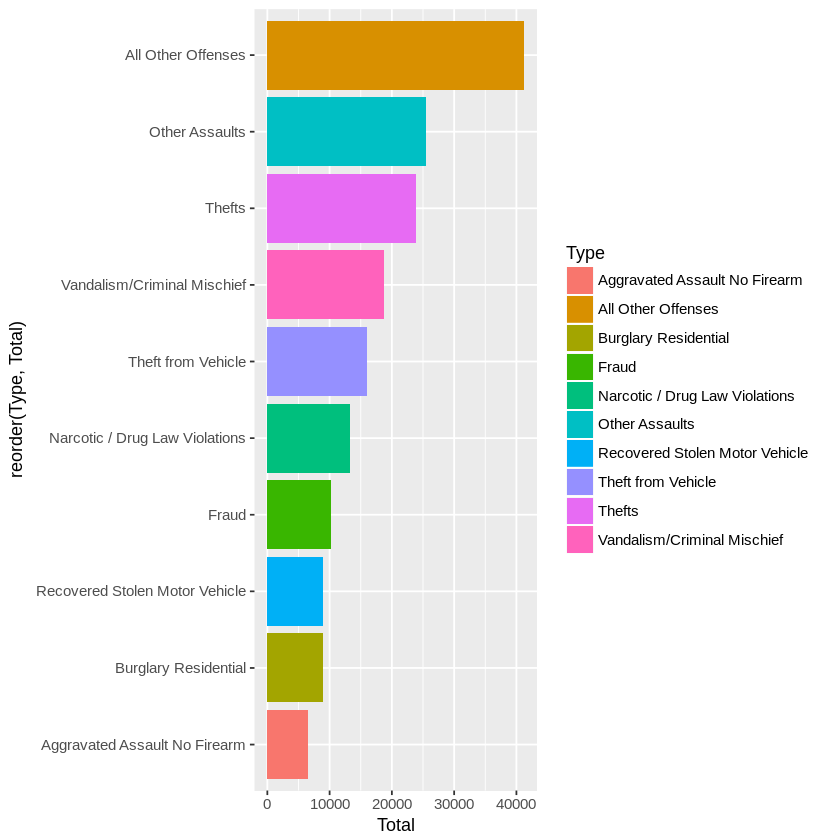

In [43]:
ggplot(top10crimes, aes(x=reorder(Type,Total), y=Total)) +
  geom_bar(aes(fill=Type), stat="identity") +
  coord_flip()

## 5. Which police HQ is in the most need of strengthening?

Count crimes by HQ

In [44]:
by_hq <- aggregate(CrimeData$Dc_Dist, by = list(HQ = CrimeData$Dc_Dist), FUN=length)

#rename columns
colnames(by_hq) <- c("HQ", "Total")

Plot the result

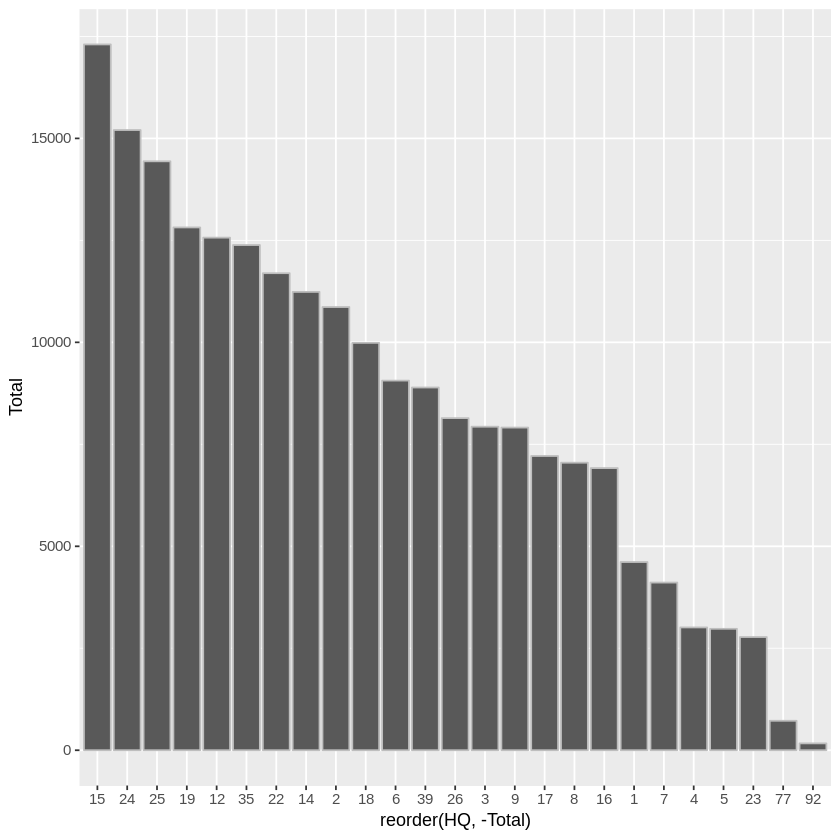

In [45]:
ggplot(by_hq, aes(reorder(HQ, -Total), Total)) +
  geom_bar(color = "gray", stat="identity")